In [3]:
import pandas as pd
import glob
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg


In [2]:
from cleanlab.filter import find_label_issues
import pandas as pd
import numpy as np

predDf = pd.read_csv(
    "/home/alextay96/Desktop/all_workspace/new_workspace/ML_Data_Debug_Tools/data/output/confidence_filtering/pred.csv"
)
print(predDf["softmax_probs"])
softmaxProbs = np.array([eval(x) for x in predDf["softmax_probs"].tolist()])
ordered_label_issues = find_label_issues(
    labels=predDf["gt"],
    pred_probs=softmaxProbs,  # predicted probabilities from any model (ideally out-of-sample predictions)
    return_indices_ranked_by="self_confidence",
    filter_by="both",
    frac_noise=0.3,
)
issueDf = predDf.iloc[ordered_label_issues]
print(issueDf)


0         [0.00017605620087124407, 0.9998239874839783]
1          [0.0006130294059403241, 0.9993869066238403]
2          [0.0005692035192623734, 0.9994307160377502]
3            [0.9716179370880127, 0.02838212437927723]
4         [0.9998984336853027, 0.00010150382877327502]
                              ...                     
143875      [0.011574994772672653, 0.9884250164031982]
143876       [0.11874229460954666, 0.8812576532363892]
143877      [0.029423581436276436, 0.9705764651298523]
143878     [0.0010464256629347801, 0.9989535808563232]
143879      [0.039564553648233414, 0.9604353904724121]
Name: softmax_probs, Length: 143880, dtype: object
        Unnamed: 0                                               file  pred  \
32583           63  /home/alextay96/Desktop/all_workspace/new_work...     0   
49210           10  /home/alextay96/Desktop/all_workspace/new_work...     0   
16053           93  /home/alextay96/Desktop/all_workspace/new_work...     0   
5483            83  /home/al

In [8]:
labelIssueDf= pd.read_parquet("/home/alextay96/Desktop/all_workspace/new_workspace/ML_Data_Debug_Tools/data/train_val/bonnet/label_issue_2.parquet")
labelIssueDf.columns

Index(['Unnamed: 0', 'file', 'pred', 'gt', 'pred_probs', 'softmax_probs',
       'part', 'filename'],
      dtype='object')

In [9]:
labelIssueDf["gt"].value_counts()

0    13102
1    10928
Name: gt, dtype: int64

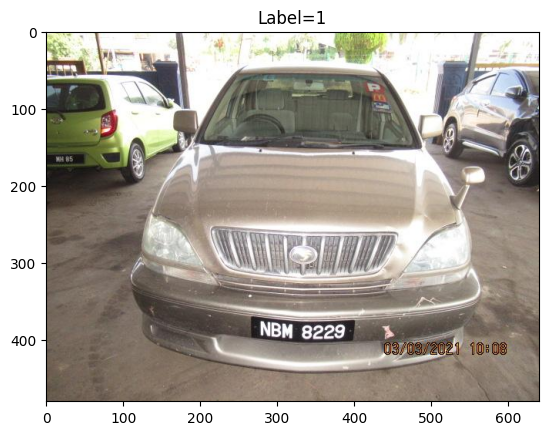

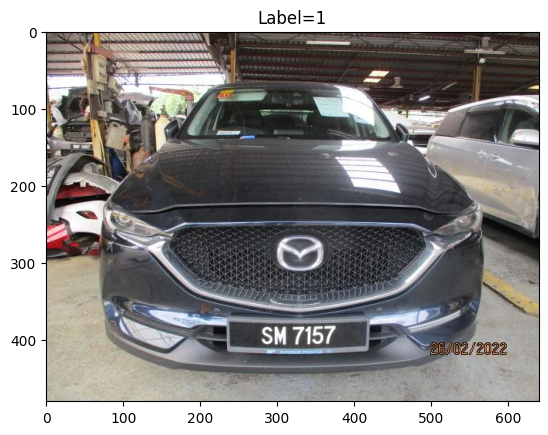

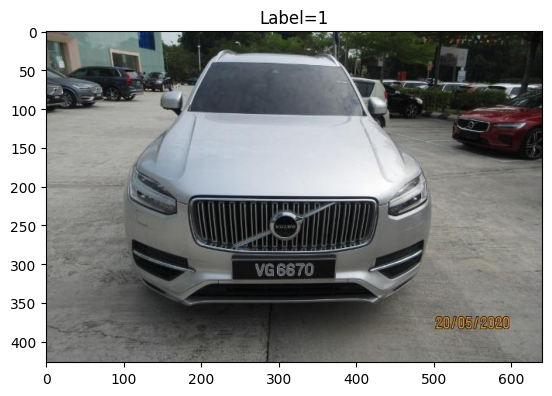

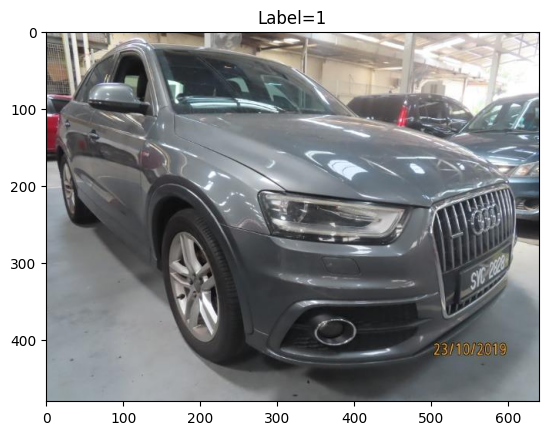

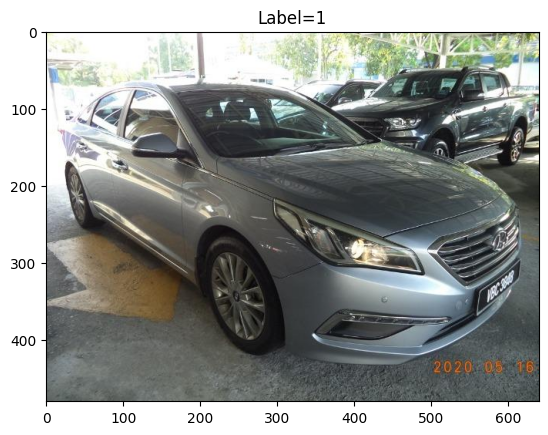

...

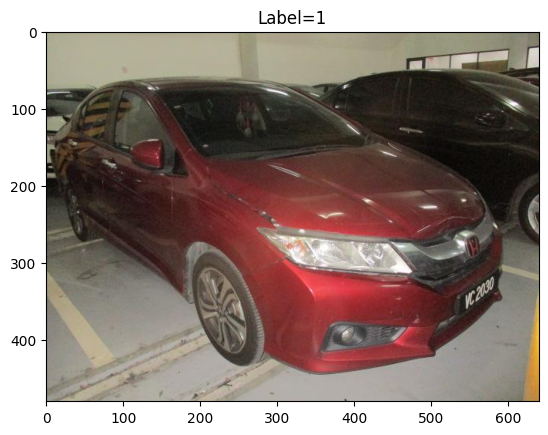

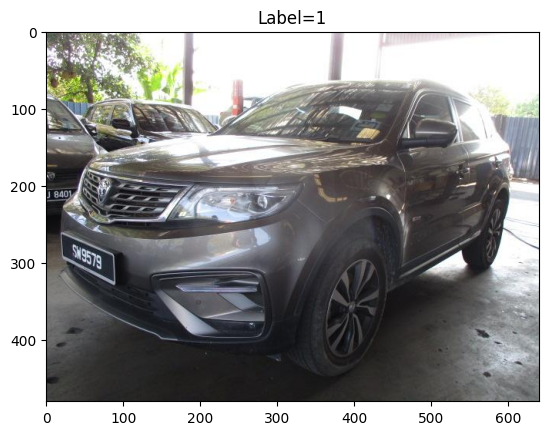

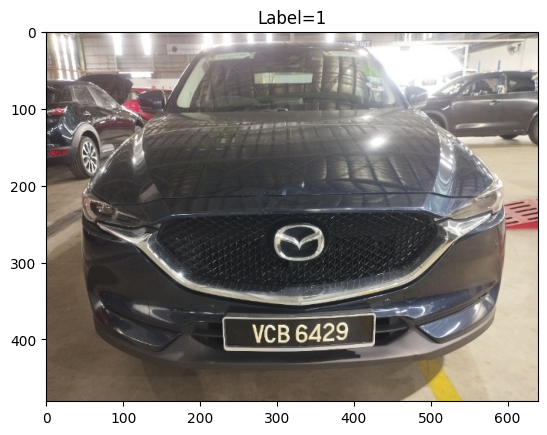

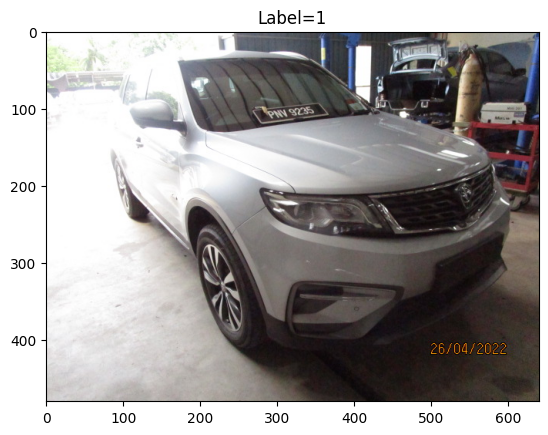

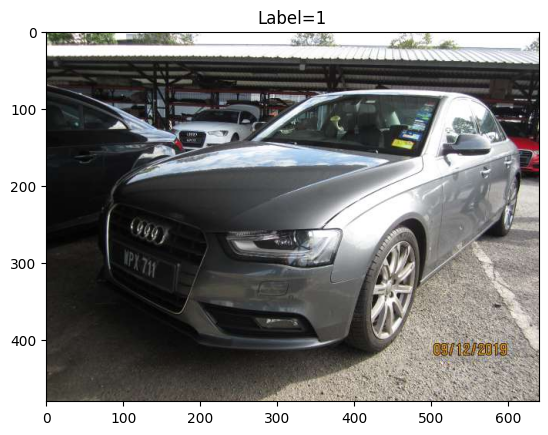

In [3]:
posIssueDf = issueDf[issueDf["gt"] == 1]
for _, row in posIssueDf.head(20).iterrows():
    img = mpimg.imread(row["file"])
    gtLabel = row["gt"]
    plt.title(f"Label={gtLabel}")
    plt.axis('off')

    fig = plt.imshow(img)
    plt.show()

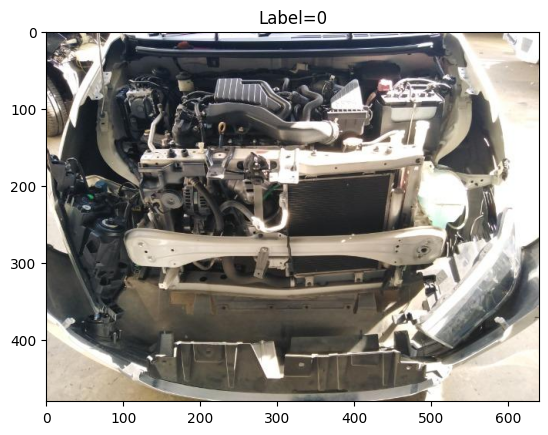

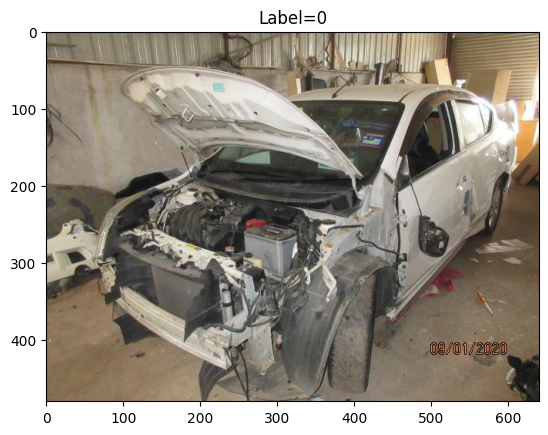

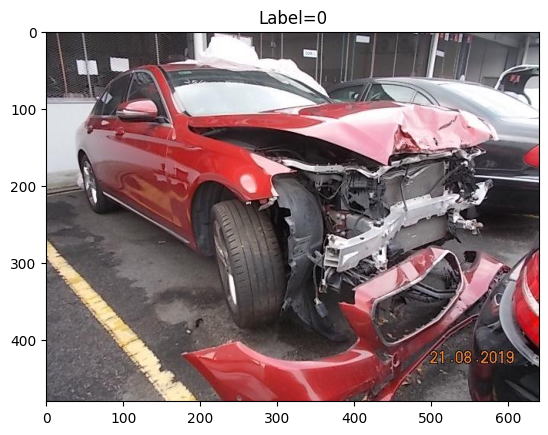

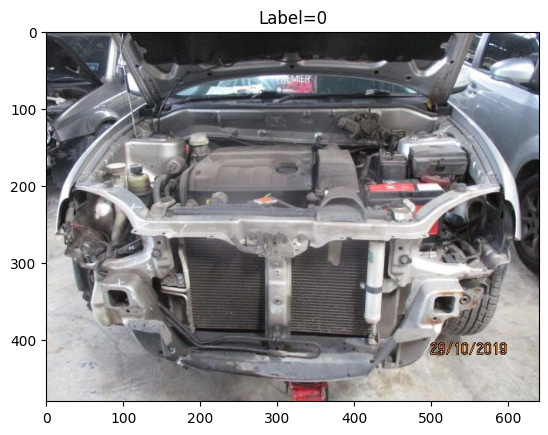

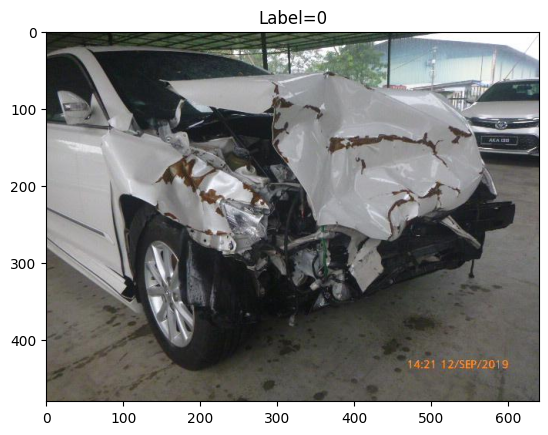

...

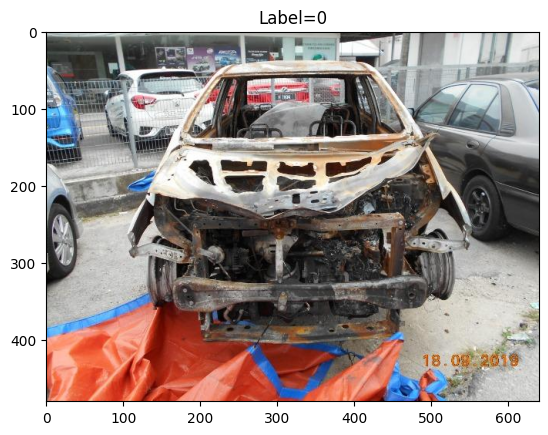

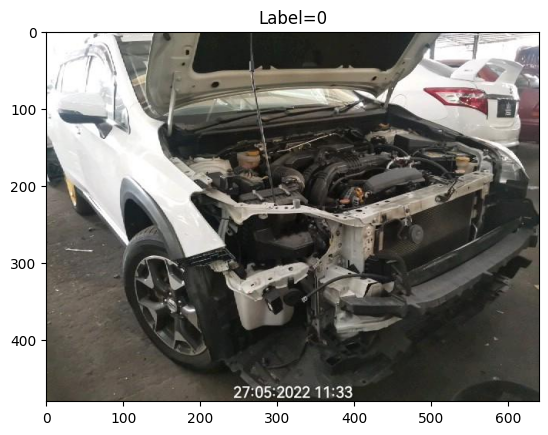

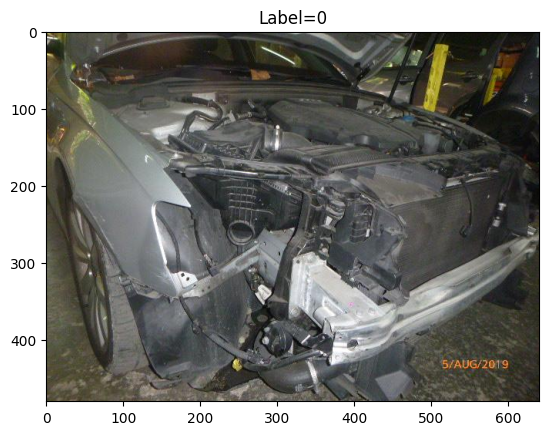

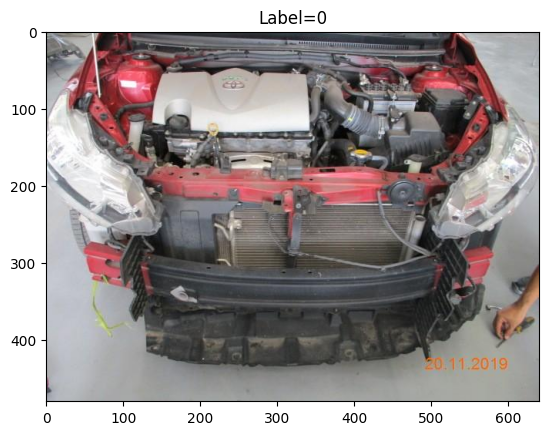

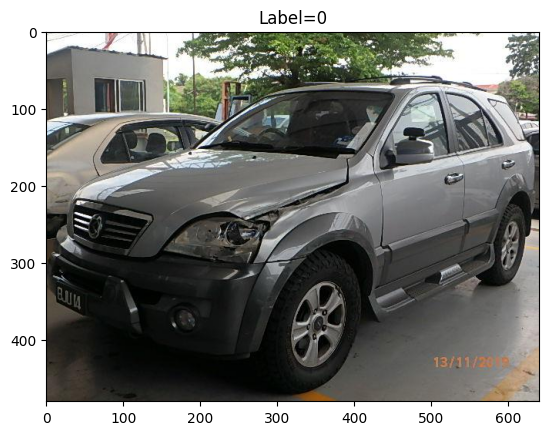

In [4]:
negIssueDf = issueDf[issueDf["gt"] == 0]
for _, row in negIssueDf.head(20).iterrows():
    img = mpimg.imread(row["file"])
    gtLabel = row["gt"]
    plt.title(f"Label={gtLabel}")
    fig = plt.imshow(img)
    plt.show()

In [5]:
raise Exception("aa")

Exception: aa

In [64]:
srcDir = "/home/alextay96/Desktop/all_workspace/new_workspace/ML_Data_Debug_Tools/data/output/bonnet"
allCsv = glob.glob(f"{srcDir}/*.csv")
debugDf = pd.concat([pd.read_csv(x) for x in allCsv])
debugDf

,Unnamed: 0,filename,contrib,curr_acc
0,0,10156251_446935407.JPG,-0.01275,0.3725
0,0,10479847_461578699.JPG,-0.01100,0.3900
1,1,10732817_474198879.JPG,0.01500,0.4050
2,2,10152147_444903779.JPG,0.07000,0.4750
3,3,10930369_483921527.JPG,-0.07500,0.4000
...,...,...,...,...
36,36,10273255_450989198.JPG,0.00500,0.3325
37,37,10124458_444849174.JPG,0.04250,0.3750
38,38,11226645_499583754.JPG,0.09250,0.4675
39,39,10025283_439695556.JPG,-0.02000,0.4475


In [65]:
debugDf.groupby("filename")["contrib"].count().reset_index()

,filename,contrib
0,10003310_437726816.JPG,1
1,10003430_437599092.JPG,1
2,10005252_437958519.JPG,1
3,10006846_437781813.JPG,1
4,10009976_438009448.JPG,4
...,...,...
761,13517833_619201034.JPG,1
762,13522418_617664386.JPG,1
763,13531277_618497994.JPG,2
764,13536883_618484292.JPG,3


In [66]:
countDf = debugDf.groupby("filename")["contrib"].count().reset_index().sort_values(by="contrib", ascending=False).rename(columns={"contrib" : "count"})
countDf

,filename,count
661,12731326_578182302.JPG,6
242,10402902_458653715.JPG,6
526,11623717_521138282.JPG,5
253,10425487_460763431.JPG,5
42,10071493_441601025.JPG,5
...,...,...
363,10702335_472364505.JPG,1
362,10697238_473518125.JPG,1
361,10696590_473013737.JPG,1
360,10671580_471022785.JPG,1


In [67]:
len(debugDf["filename"].unique())

766

In [68]:

debugAggDf = debugDf.groupby("filename")["contrib"].mean().reset_index()
debugAggDf.sort_values(by="contrib", ascending=False, inplace=True)
debugAggDf = debugAggDf.merge(countDf, on="filename")

In [69]:
imgDir = "/home/alextay96/Desktop/all_workspace/new_workspace/DLDataPipeline/data/imgs"
debugAggDf["filepath"] = debugAggDf["filename"].apply(lambda x : os.path.join(imgDir, x))
debugAggDf = debugAggDf[debugAggDf["count"] > 3].sort_values(by="contrib", ascending=True)

In [70]:
debugAggDf

,filename,contrib,count,filepath
715,10425487_460763431.JPG,-0.093000,5,/home/alextay96/Desktop/all_workspace/new_work...
687,10157602_445211509.JPG,-0.071250,4,/home/alextay96/Desktop/all_workspace/new_work...
638,10059094_440302633.JPG,-0.051250,4,/home/alextay96/Desktop/all_workspace/new_work...
628,11009328_489082634.JPG,-0.049375,4,/home/alextay96/Desktop/all_workspace/new_work...
619,13173054_599872209.JPG,-0.046250,4,/home/alextay96/Desktop/all_workspace/new_work...
...,...,...,...,...
123,10053856_440709439.JPG,0.054375,4,/home/alextay96/Desktop/all_workspace/new_work...
119,10411273_459987853.JPG,0.055000,4,/home/alextay96/Desktop/all_workspace/new_work...
100,10861730_481095776.JPG,0.063500,5,/home/alextay96/Desktop/all_workspace/new_work...
45,12976879_589972186.JPG,0.096875,4,/home/alextay96/Desktop/all_workspace/new_work...


In [71]:
labelDf = pd.read_csv("/home/alextay96/Desktop/all_workspace/new_workspace/ML_Data_Debug_Tools/data/train_val/bonnet/train_shapley.csv")
labelDf

,Unnamed: 0,CaseID,filename,bonnet
0,0,10000064,10000064_440265954.JPG,1
1,1,10000064,10000064_440567975.JPG,1
2,2,10000064,10000064_440265955.JPG,1
3,3,10000117,10000117_437288764.JPG,0
4,4,10000117,10000117_437288763.JPG,0
...,...,...,...,...
269900,269900,12416156,12416156_561333680.JPG,1
269901,269901,12847918,12847918_583482639.JPG,1
269902,269902,13022575,13022575_592267708.JPG,0
269903,269903,13222048,13222048_602857748.JPG,0


In [72]:
debugAggDf = debugAggDf.merge(labelDf, on="filename")

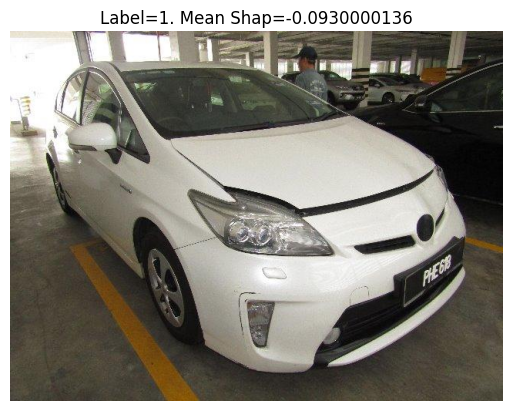

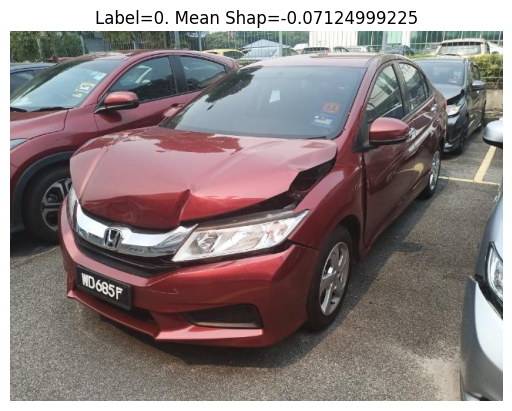

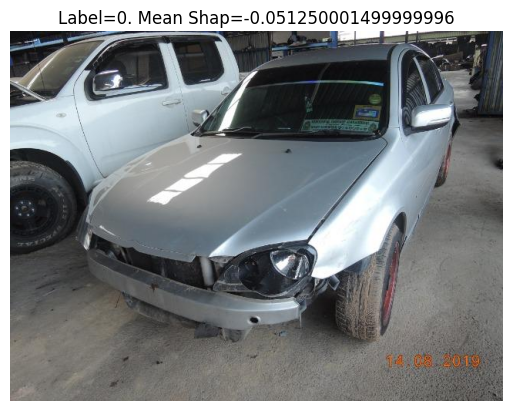

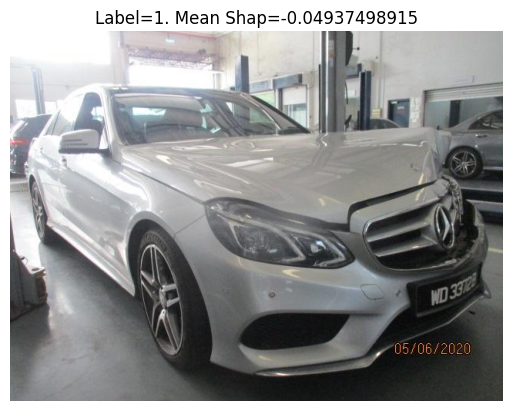

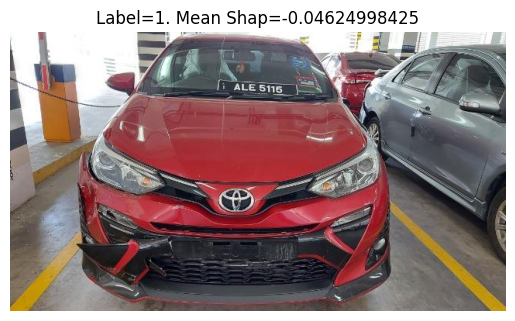

...

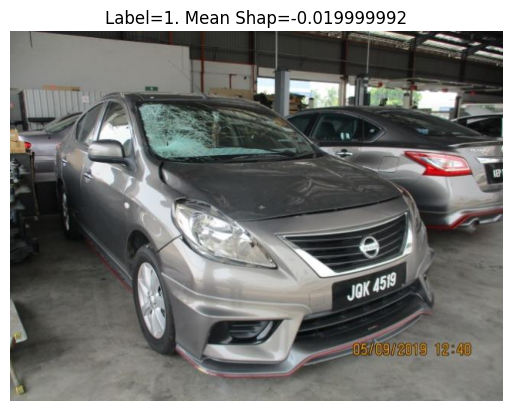

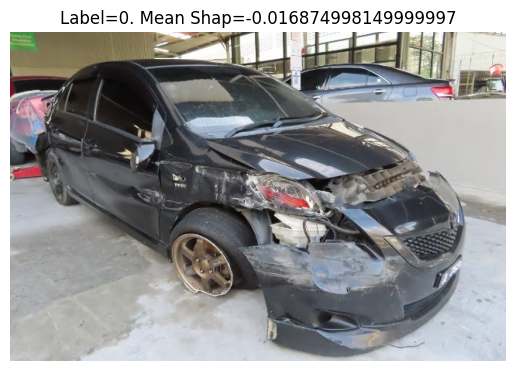

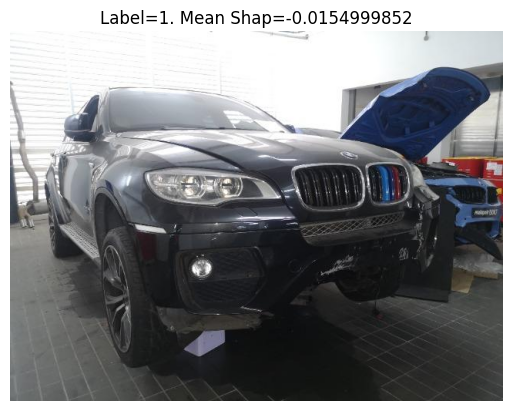

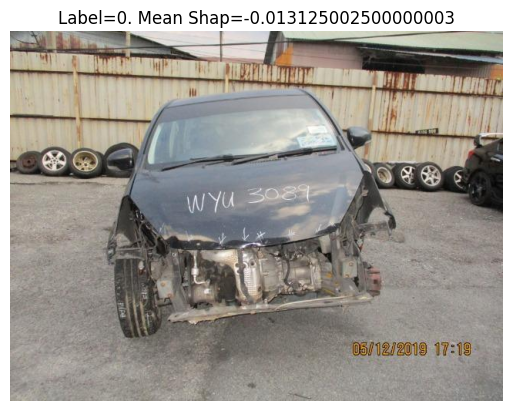

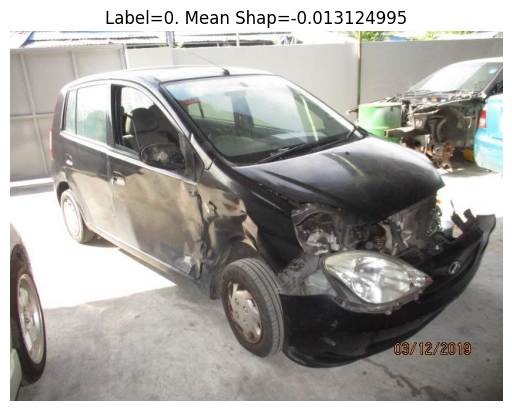

In [73]:
for _, row in debugAggDf.head(20).iterrows():
    img = mpimg.imread(row["filepath"])
    gtLabel = row["bonnet"]
    meanShapScore = row["contrib"]
    plt.title(f"Label={gtLabel}. Mean Shap={meanShapScore}")
    plt.axis('off')
    fig = plt.imshow(img)
    plt.show()